<a href="https://colab.research.google.com/github/neginnoori/window_detection/blob/main/window_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import shutil

In [2]:
!pip install kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d nderalparslan/dwsonder
!unzip dwsonder.zip -d ./dwsonder

Streaming output truncated to the last 5000 lines.
  inflating: ./dwsonder/images/1cc00d946d527251.txt  
  inflating: ./dwsonder/images/1cc919e1ed5a71e1.jpg  
  inflating: ./dwsonder/images/1cc919e1ed5a71e1.txt  
  inflating: ./dwsonder/images/1ccba45e8e4491a3.jpg  
  inflating: ./dwsonder/images/1ccba45e8e4491a3.txt  
  inflating: ./dwsonder/images/1cdb00bbeb6f8852.jpg  
  inflating: ./dwsonder/images/1cdb00bbeb6f8852.txt  
  inflating: ./dwsonder/images/1cdd6c9709932813.jpg  
  inflating: ./dwsonder/images/1cdd6c9709932813.txt  
  inflating: ./dwsonder/images/1d01e2a7bebbb07f.jpg  
  inflating: ./dwsonder/images/1d01e2a7bebbb07f.txt  
  inflating: ./dwsonder/images/1d05f63fa8d0b663.jpg  
  inflating: ./dwsonder/images/1d05f63fa8d0b663.txt  
  inflating: ./dwsonder/images/1d0e6bb123befc16.jpg  
  inflating: ./dwsonder/images/1d0e6bb123befc16.txt  
  inflating: ./dwsonder/images/1d3362e5d8346e5b.jpg  
  inflating: ./dwsonder/images/1d3362e5d8346e5b.txt  
  inflating: ./dwsonder/images/

In [ ]:
!unzip dwsonder.zip -d ./dwsonder

Streaming output truncated to the last 5000 lines.
  inflating: ./dwsonder/images/1cc00d946d527251.txt  
  inflating: ./dwsonder/images/1cc919e1ed5a71e1.jpg  
  inflating: ./dwsonder/images/1cc919e1ed5a71e1.txt  
  inflating: ./dwsonder/images/1ccba45e8e4491a3.jpg  
  inflating: ./dwsonder/images/1ccba45e8e4491a3.txt  
  inflating: ./dwsonder/images/1cdb00bbeb6f8852.jpg  
  inflating: ./dwsonder/images/1cdb00bbeb6f8852.txt  
  inflating: ./dwsonder/images/1cdd6c9709932813.jpg  
  inflating: ./dwsonder/images/1cdd6c9709932813.txt  
  inflating: ./dwsonder/images/1d01e2a7bebbb07f.jpg  
  inflating: ./dwsonder/images/1d01e2a7bebbb07f.txt  
  inflating: ./dwsonder/images/1d05f63fa8d0b663.jpg  
  inflating: ./dwsonder/images/1d05f63fa8d0b663.txt  
  inflating: ./dwsonder/images/1d0e6bb123befc16.jpg  
  inflating: ./dwsonder/images/1d0e6bb123befc16.txt  
  inflating: ./dwsonder/images/1d3362e5d8346e5b.jpg  
  inflating: ./dwsonder/images/1d3362e5d8346e5b.txt  
  inflating: ./dwsonder/images/

In [3]:
import os
import shutil

# Define source directory containing images and labels
source_dir = '/content/dwsonder/images'

# Define target directory for the dataset
dataset_dir = '/content/dataset'

# Create dataset directory if it doesn't exist
os.makedirs(dataset_dir, exist_ok=True)

# Define file extensions for images and labels
image_extensions = ('.png', '.jpg', '.jpeg', '.bmp', '.gif')
label_extension = '.txt'

# List all image files in source directory
image_files = [f for f in os.listdir(source_dir) if f.lower().endswith(image_extensions)]

# Process each image file
for image_filename in image_files:
    # Construct paths for image and label
    image_path = os.path.join(source_dir, image_filename)
    label_filename = os.path.splitext(image_filename)[0] + label_extension
    label_path = os.path.join(source_dir, label_filename)

    # Check if label file exists
    if os.path.exists(label_path):
        # Read label content
        with open(label_path, 'r') as label_file:
            lines = label_file.readlines()

        # Check each line in the label file
        for line in lines:
            # Split line into components
            parts = line.strip().split()
            if len(parts) < 5:
                continue

            class_label = parts[0]  # First element is the class label (0 or 2)

            # Check if class label is '0' or '2'
            if class_label in ['0', '2']:
                # Create directories for images and labels in dataset_dir if they don't exist
                images_target_dir = os.path.join(dataset_dir, 'images')
                labels_target_dir = os.path.join(dataset_dir, 'labels')
                os.makedirs(images_target_dir, exist_ok=True)
                os.makedirs(labels_target_dir, exist_ok=True)

                # Move image to dataset/images
                shutil.move(image_path, os.path.join(images_target_dir, image_filename))

                # Move label to dataset/labels (keeping the same name)
                shutil.move(label_path, os.path.join(labels_target_dir, label_filename))

                print(f'Moved {image_filename} and {label_filename} to dataset.')
                break  # Move the first label line and break out of the loop
            else:
                print(f'Skipping {image_filename} and {label_filename} because class label is {class_label}.')
    else:
        print(f'Label file {label_filename} not found for {image_filename}.')

print('Processing completed.')

Moved 04e603dbe6e114fa.jpg and 04e603dbe6e114fa.txt to dataset.
Skipping IMG_20181029_153604.jpg and IMG_20181029_153604.txt because class label is 1.
Moved 30beea9db4d053df.jpg and 30beea9db4d053df.txt to dataset.
Moved 0490858d70db45bb.jpg and 0490858d70db45bb.txt to dataset.
Moved 57cea5606fb7fdc4.jpg and 57cea5606fb7fdc4.txt to dataset.
Skipping IMG_20181029_143942.jpg and IMG_20181029_143942.txt because class label is 1.
Moved 02fd765339dde84f.jpg and 02fd765339dde84f.txt to dataset.
Skipping IMG_20181022_001415_flipped.jpg and IMG_20181022_001415_flipped.txt because class label is 1.
Moved 210a0f1af20b7255.jpg and 210a0f1af20b7255.txt to dataset.
Moved 052aa8c71641861d.jpg and 052aa8c71641861d.txt to dataset.
Moved 001ee6fed11692a3.jpg and 001ee6fed11692a3.txt to dataset.
Moved 0d34c6ef6030ef6c.jpg and 0d34c6ef6030ef6c.txt to dataset.
Moved 0134e56c45fa2f67.jpg and 0134e56c45fa2f67.txt to dataset.
Moved 03538041cffc21d1.jpg and 03538041cffc21d1.txt to dataset.
Moved 058da0e936c23

In [4]:
for image_filename in image_files[:200]:
    # Construct paths for image and label
    image_path = os.path.join(source_dir, image_filename)
    label_filename = os.path.splitext(image_filename)[0] + label_extension
    label_path = os.path.join(source_dir, label_filename)

    # Check if label file exists
    if os.path.exists(label_path):
        # Read label content
        with open(label_path, 'r') as label_file:
            lines = label_file.readlines()

        # Check each line in the label file
        for line in lines:
            # Split line into components
            parts = line.strip().split()
            if len(parts) < 5:
                continue

            class_label = parts[0]  # First element is the class label (0 or 2)

            # Check if class label is '0' or '2'
            if class_label in ['1']:
                # Create directories for images and labels in dataset_dir if they don't exist
                images_target_dir = os.path.join(dataset_dir, 'images')
                labels_target_dir = os.path.join(dataset_dir, 'labels')
                os.makedirs(images_target_dir, exist_ok=True)
                os.makedirs(labels_target_dir, exist_ok=True)

                # Move image to dataset/images
                shutil.move(image_path, os.path.join(images_target_dir, image_filename))

                # Move label to dataset/labels (keeping the same name)
                shutil.move(label_path, os.path.join(labels_target_dir, label_filename))

                print(f'Moved {image_filename} and {label_filename} to dataset.')
                break  # Move the first label line and break out of the loop
            else:
                print(f'Skipping {image_filename} and {label_filename} because class label is {class_label}.')
    else:
        print(f'Label file {label_filename} not found for {image_filename}.')

print('Processing completed.')

Label file 04e603dbe6e114fa.txt not found for 04e603dbe6e114fa.jpg.
Moved IMG_20181029_153604.jpg and IMG_20181029_153604.txt to dataset.
Label file 30beea9db4d053df.txt not found for 30beea9db4d053df.jpg.
Label file 0490858d70db45bb.txt not found for 0490858d70db45bb.jpg.
Label file 57cea5606fb7fdc4.txt not found for 57cea5606fb7fdc4.jpg.
Moved IMG_20181029_143942.jpg and IMG_20181029_143942.txt to dataset.
Label file 02fd765339dde84f.txt not found for 02fd765339dde84f.jpg.
Moved IMG_20181022_001415_flipped.jpg and IMG_20181022_001415_flipped.txt to dataset.
Label file 210a0f1af20b7255.txt not found for 210a0f1af20b7255.jpg.
Label file 052aa8c71641861d.txt not found for 052aa8c71641861d.jpg.
Label file 001ee6fed11692a3.txt not found for 001ee6fed11692a3.jpg.
Label file 0d34c6ef6030ef6c.txt not found for 0d34c6ef6030ef6c.jpg.
Label file 0134e56c45fa2f67.txt not found for 0134e56c45fa2f67.jpg.
Label file 03538041cffc21d1.txt not found for 03538041cffc21d1.jpg.
Label file 058da0e936c2340

In [24]:
import shutil
import os

# Path to the folder you want to delete
folder_path = '/content/yolo_data'

# Check if the folder exists
if os.path.exists(folder_path):
    # Delete the folder
    shutil.rmtree(folder_path)
    print(f"Folder '{folder_path}' has been deleted.")
else:
    print(f"Folder '{folder_path}' does not exist.")

Folder '/content/yolo_data' has been deleted.


In [5]:
images_dir = '/content/dataset/images'
image_extensions = ('.png', '.jpg', '.jpeg', '.bmp', '.gif')
all_files = os.listdir(images_dir)
image_files = [f for f in all_files if f.lower().endswith(image_extensions)]
num_images = len(image_files)
print(f'The number of images in the images folder is: {num_images}')

The number of images in the images folder is: 3392


In [6]:
labels_dir = '/content/dataset/labels'
label_extensions = ('.txt', '.json')
all_files = os.listdir(labels_dir)
label_files = [f for f in all_files if f.lower().endswith(label_extensions)]
num_labels = len(label_files)
print(f'The number of labels in the labels folder is: {num_labels}')

The number of labels in the labels folder is: 3392


In [25]:
image_basenames = {os.path.splitext(f)[0] for f in image_files}
label_basenames = {os.path.splitext(f)[0] for f in label_files}

labels_without_images = label_basenames - image_basenames

print(f'The number of labels without corresponding images is: {len(labels_without_images)}')

remove_unmatched_labels = True

if remove_unmatched_labels:
    for label in labels_without_images:
        for ext in label_extensions:
            label_path = os.path.join(labels_dir, label + ext)
            if os.path.exists(label_path):
                os.remove(label_path)
                print(f'Removed label: {label_path}')

print('Unmatched labels have been removed.')

The number of labels without corresponding images is: 0
Unmatched labels have been removed.


In [7]:
import random

random.seed(42)
base_dir = './Window_data'

train_images_dir = os.path.join(base_dir, 'train/images')
train_labels_dir = os.path.join(base_dir, 'train/labels')
val_images_dir = os.path.join(base_dir, 'val/images')
val_labels_dir = os.path.join(base_dir, 'val/labels')

os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(train_labels_dir, exist_ok=True)
os.makedirs(val_images_dir, exist_ok=True)
os.makedirs(val_labels_dir, exist_ok=True)

image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(image_extensions)]
label_files = [f for f in os.listdir(labels_dir) if f.lower().endswith(label_extensions)]

image_basenames = {os.path.splitext(f)[0] for f in image_files}
label_basenames = {os.path.splitext(f)[0] for f in label_files}
common_basenames = list(image_basenames & label_basenames)

random.shuffle(common_basenames)

train_ratio = 0.7
val_ratio = 1 - train_ratio

train_index = int(len(common_basenames) * train_ratio)
val_index = len(common_basenames) - train_index

train_basenames = common_basenames[:train_index]
val_basenames = common_basenames[train_index:train_index + val_index]

def move_files(basenames, source_dir, target_dir, extensions):
    for basename in basenames:
        for ext in extensions:
            src_path = os.path.join(source_dir, basename + ext)
            if os.path.exists(src_path):
                shutil.move(src_path, os.path.join(target_dir, basename + ext))

move_files(train_basenames, images_dir, train_images_dir, image_extensions)
move_files(train_basenames, labels_dir, train_labels_dir, label_extensions)

move_files(val_basenames, images_dir, val_images_dir, image_extensions)
move_files(val_basenames, labels_dir, val_labels_dir, label_extensions)

print('Dataset has been split into train and val sets with images and labels in respective directories.')

Dataset has been split into train and val sets with images and labels in respective directories.


In [8]:
import torch
from torch.utils.data import Dataset
from PIL import Image
import os
import numpy as np
import torch
import glob
import matplotlib.pyplot as plt

In [9]:
class Window_Data(Dataset):
    def __init__(self, root_dir, subset, transform=None, trans_params=None):

        assert subset in ['train', 'val'], "subset should be 'train' or 'val'"

        # Get list of images
        img_dir = os.path.join(root_dir, subset, 'images')
        self.path2imgs = glob.glob(os.path.join(img_dir, '*.png')) + glob.glob(os.path.join(img_dir, '*.jpg'))

        # Get list of labels
        self.path2labels = [
            path.replace("images", "labels").replace(".png", ".txt").replace(".jpg", ".txt")
            for path in self.path2imgs
        ]

        self.trans_params = trans_params
        self.transform = transform

    def __len__(self):
        return len(self.path2imgs)

    def __getitem__(self, index):
        path2img = self.path2imgs[index % len(self.path2imgs)]
        img = Image.open(path2img).convert('RGB')

        path2label = self.path2labels[index % len(self.path2imgs)]

        labels = None
        if os.path.exists(path2label):
            labels = np.loadtxt(path2label).reshape(-1, 5)

        if self.transform:
            img, labels = self.transform(img, labels, self.trans_params)

        # Convert labels to tensor (if not None)
        labels = torch.from_numpy(labels) if labels is not None else labels

        return img, labels, path2img

In [26]:
root_data = "./Window_data"
Window_train = Window_Data(root_dir=root_data, subset="train", transform=None, trans_params=None)
print(len(Window_train))

2356


In [ ]:
Window_train = []

for i in range(len(Window_trainn)):
    img, labels, path2img  = Window_trainn[i]
    if labels.any() == True:
        print(i)
        print(labels)
        Window_train.append(Window_trainn[i])


Streaming output truncated to the last 5000 lines.
1420
tensor([[1.0000, 0.5072, 0.4248, 0.9518, 0.1493],
        [0.0000, 0.1960, 0.1855, 0.1133, 0.3490],
        [0.0000, 0.3062, 0.1881, 0.1124, 0.3472]], dtype=torch.float64)
1421
tensor([[2.0000, 0.5850, 0.3870, 0.0500, 0.0385]], dtype=torch.float64)
1422
tensor([[2.0000, 0.3625, 0.5287, 0.0438, 0.0375],
        [2.0000, 0.3669, 0.4458, 0.0425, 0.0417],
        [2.0000, 0.4006, 0.5279, 0.0137, 0.0308],
        [2.0000, 0.4316, 0.4537, 0.0269, 0.0358],
        [2.0000, 0.5053, 0.4633, 0.0506, 0.0417],
        [2.0000, 0.5041, 0.5454, 0.0456, 0.0408],
        [2.0000, 0.6562, 0.4804, 0.0300, 0.0325],
        [2.0000, 0.8728, 0.5171, 0.0181, 0.0292],
        [2.0000, 0.8741, 0.5687, 0.0206, 0.0258]], dtype=torch.float64)
1423
tensor([[0.0000, 0.6855, 0.4746, 0.3750, 0.7383]], dtype=torch.float64)
1424
tensor([[2.0000, 0.7003, 0.1975, 0.1356, 0.2300]], dtype=torch.float64)
1425
tensor([[2.0000, 0.1288, 0.7025, 0.2575, 0.3500],
        [

In [27]:
print(len(Window_train))

2356


In [12]:
print(len(Window_train))
print(Window_train[0])
img, labels, path2img = Window_train[200]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)

2356
(<PIL.Image.Image image mode=RGB size=1024x678 at 0x7AA114DC5ED0>, tensor([[0.0000, 0.2563, 0.7537, 0.0850, 0.3127],
        [0.0000, 0.7646, 0.6858, 0.0605, 0.2360]], dtype=torch.float64), './Window_data/train/images/30beea9db4d053df.jpg')
image size: (1024, 683) <class 'PIL.Image.Image'>
labels shape: torch.Size([18, 5]) <class 'torch.Tensor'>
labels 
 tensor([[2.0000, 0.1956, 0.4174, 0.0438, 0.3396],
        [2.0000, 0.2419, 0.4339, 0.0363, 0.2992],
        [2.0000, 0.3644, 0.2491, 0.1188, 0.2767],
        [2.0000, 0.3828, 0.5539, 0.0231, 0.1792],
        [2.0000, 0.4022, 0.5521, 0.0181, 0.1642],
        [2.0000, 0.4194, 0.5530, 0.0212, 0.1454],
        [2.0000, 0.4578, 0.3973, 0.0444, 0.1623],
        [2.0000, 0.4609, 0.2317, 0.0406, 0.1388],
        [2.0000, 0.5034, 0.3241, 0.0406, 0.1417],
        [2.0000, 0.5066, 0.4648, 0.0419, 0.1079],
        [2.0000, 0.8184, 0.3035, 0.0281, 0.1923],
        [2.0000, 0.8209, 0.0652, 0.0231, 0.1304],
        [2.0000, 0.8209, 0.5877, 0.023

In [13]:
window_val = Window_Data(root_dir=root_data, subset="val", transform=None, trans_params=None)
print(len(window_val))

1008


In [ ]:
window_val = []

for i in range(len(window_vall)):
    img, labels, path2img  = window_vall[i]
    if labels.any() == True:
        print(i)
        print(labels)
        window_val.append(window_vall[i])

NameError: name 'window_vall' is not defined

In [14]:
print(len(window_val))
img, labels, path2img = window_val[7]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)

1008
image size: (2304, 1296) <class 'PIL.Image.Image'>
labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
labels 
 tensor([[1.0000, 0.4346, 0.3175, 0.0718, 0.3526]], dtype=torch.float64)


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_image_with_bboxes(img, labels):

    img = np.array(img)

    fig, ax = plt.subplots(1)
    ax.imshow(img)

    if labels is not None:
        for label in labels:
            class_id, x_center, y_center, width, height = label
            x_min = x_center - width / 2
            y_min = y_center - height / 2

            rect = patches.Rectangle((x_min * img.shape[1], y_min * img.shape[0]),
                                     width * img.shape[1], height * img.shape[0],
                                     linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            plt.text(x_min * img.shape[1], y_min * img.shape[0], str(int(class_id)),
                     color='white', verticalalignment='top', bbox={'facecolor': 'red', 'alpha': 0.5, 'pad': 1})

    plt.axis('off')
    plt.show()

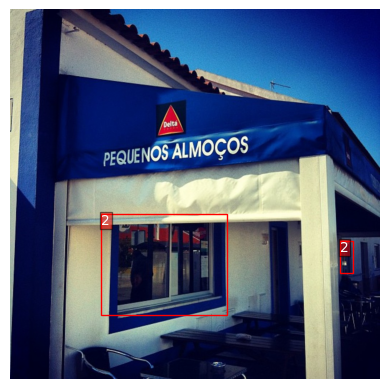

In [ ]:
img, labels, path2img = Window_train[3335]
plot_image_with_bboxes(img, labels)

## **Data Aug**

In [ ]:
import importlib
importlib.invalidate_caches()
from torchvision.transforms.functional import to_pil_image
import random
import numpy as np
import torch
import torchvision.transforms.functional as TF
import matplotlib.pyplot as plt

In [ ]:
def pad_to_square(img, boxes, pad_value=0, normalized_labels=True):
    w, h = img.size
    w_factor, h_factor = (w, h) if normalized_labels else (1, 1)

    dim_diff = np.abs(h - w)
    pad1 = dim_diff // 2
    pad2 = dim_diff - pad1

    if h <= w:
        padding = (0, pad1, 0, pad2)
    else:
        padding = (pad1, 0, pad2, 0)

    img_padded = TF.pad(img, padding=padding, fill=pad_value)
    w_padded, h_padded = img_padded.size

    x1 = w_factor * (boxes[:, 1] - boxes[:, 3] / 2)
    y1 = h_factor * (boxes[:, 2] - boxes[:, 4] / 2)
    x2 = w_factor * (boxes[:, 1] + boxes[:, 3] / 2)
    y2 = h_factor * (boxes[:, 2] + boxes[:, 4] / 2)

    x1 += padding[0]  # left
    y1 += padding[1]  # top
    x2 += padding[2]  # right
    y2 += padding[3]  # bottom

    boxes[:, 1] = ((x1 + x2) / 2) / w_padded
    boxes[:, 2] = ((y1 + y2) / 2) / h_padded
    boxes[:, 3] *= w_factor / w_padded
    boxes[:, 4] *= h_factor / h_padded

    return img_padded, boxes

In [ ]:
import torchvision.transforms.functional as TF
from PIL import ImageEnhance

def hflip(image, labels):
    image = TF.hflip(image)
    labels[:, 1] = 1.0 - labels[:, 1]
    return image, labels

def vflip(image, labels):
    image = TF.vflip(image)
    labels[:, 2] = 1.0 - labels[:, 2]
    return image, labels

def adjust_brightness(image, factor):
    enhancer = ImageEnhance.Brightness(image)
    image = enhancer.enhance(factor)
    return image

def adjust_contrast(image, factor):
    enhancer = ImageEnhance.Contrast(image)
    image = enhancer.enhance(factor)
    return image

def pad_to_square(image, labels, pad_value=0, normalized_labels=True):
    W, H = image.size(-1), image.size(-2)
    max_side = max(W, H)

    padded_img = TF.pad(image, (0, 0, max_side - W, max_side - H), fill=pad_value)

    if normalized_labels:
        labels[:, 1] = (labels[:, 1] * W + (max_side - W) // 2) / max_side
        labels[:, 2] = (labels[:, 2] * H + (max_side - H) // 2) / max_side
        labels[:, 3] = labels[:, 3] * W / max_side
        labels[:, 4] = labels[:, 4] * H / max_side
    else:
        labels[:, 1] += (max_side - W) // 2
        labels[:, 2] += (max_side - H) // 2

    return padded_img, labels

def resize(image, target_size):
    return TF.resize(image, target_size)

In [ ]:

def transformer(image, labels, params):
    if params["pad2square"]:
        image, labels = pad_to_square(image, labels, normalized_labels=params["normalized_labels"])

    image = resize(image, params["target_size"])

    if random.random() < params["p_hflip"]:
        image, labels = hflip(image, labels)

    if random.random() < params["p_vflip"]:
        image, labels = vflip(image, labels)

    if "brightness" in params:
        image = adjust_brightness(image, params["brightness"])

    if "contrast" in params:
        image = adjust_contrast(image, params["contrast"])

    image = TF.to_tensor(image)
    targets = torch.zeros((len(labels), 6))
    targets[:, 1:] = torch.from_numpy(labels)

    return image, targets




image size: (683, 1024) <class 'PIL.Image.Image'>
labels shape: torch.Size([2, 5]) <class 'torch.Tensor'>
labels 
 tensor([[2.0000, 0.6937, 0.6022, 0.0310, 0.0681],
        [2.0000, 0.7702, 0.5922, 0.0619, 0.1056]], dtype=torch.float64)


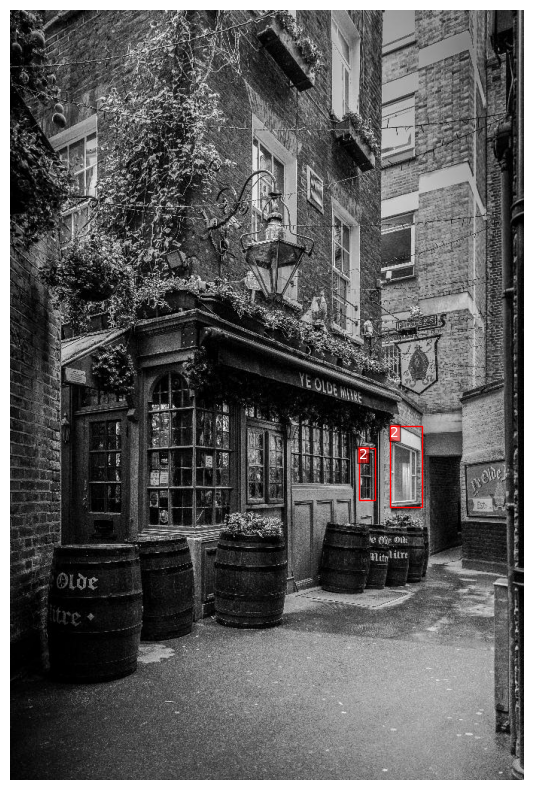

image size: (2304, 1728) <class 'PIL.Image.Image'>
labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
labels 
 tensor([[1.0000, 0.4553, 0.6311, 0.7248, 0.4959]], dtype=torch.float64)


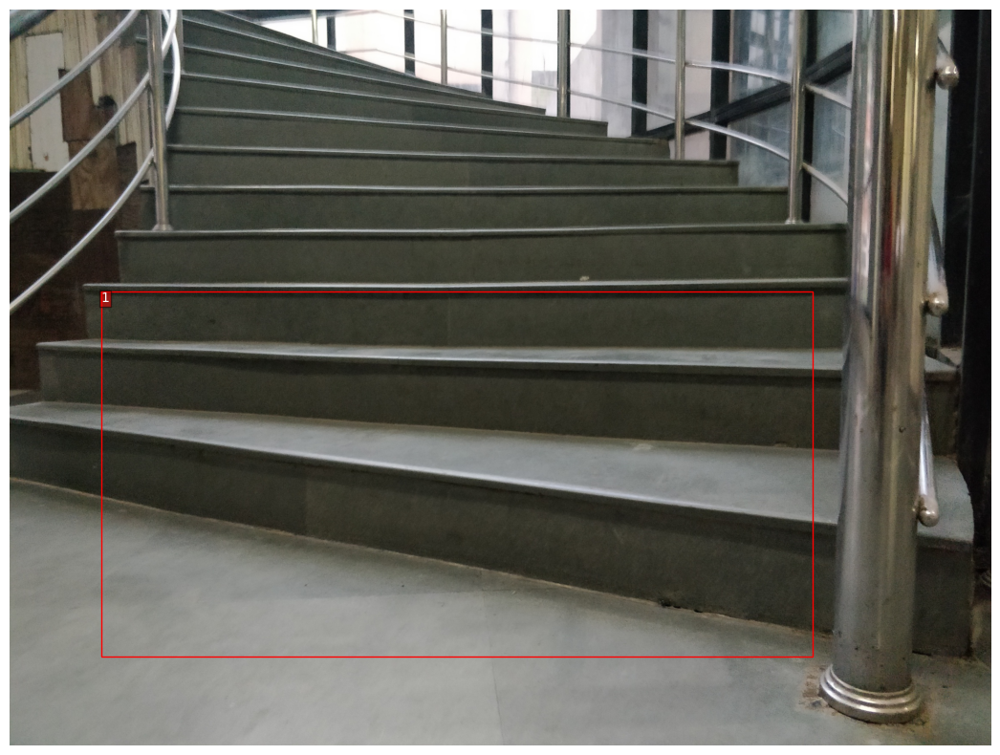

In [ ]:
COLORS = np.random.randint(0, 255, size=(80, 3), dtype="uint8")

trans_params_train = {
    "target_size": (416, 416),
    "pad2square": True,
    "p_hflip": 0.5,
    "p_vflip": 0.5,
    "brightness": 0.9,
    "contrast": 0.9,
    "normalized_labels": True,
}


np.random.seed(20)
rnd_ind = np.random.randint(len(Window_train))
img, labels, path2img = Window_train[rnd_ind]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)

plt.rcParams['figure.figsize'] = (20, 10)
plot_image_with_bboxes(img, labels)

np.random.seed(60)
rnd_ind = np.random.randint(len(window_val))
img, labels, path2img = window_val[rnd_ind]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)

plt.rcParams['figure.figsize'] = (20, 10)
plot_image_with_bboxes(img, labels)


In [ ]:
def rescale_bbox(bb, W, H):
    if len(bb) < 4:
        return bb  # Return bb unchanged if it doesn't have at least 4 elements

    x, y, w, h = bb[:4]  # Take the first four elements if available
    return (x * W, y * H, w * W, h * H)

Visualizing samples from Window_train:
Image size: (1024, 713) <class 'PIL.Image.Image'>
Labels shape: torch.Size([3, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[2.0000, 0.4326, 0.3324, 0.0801, 0.0757],
        [2.0000, 0.5864, 0.3338, 0.0771, 0.0870],
        [0.0000, 0.5889, 0.5021, 0.0762, 0.2609]], dtype=torch.float64)


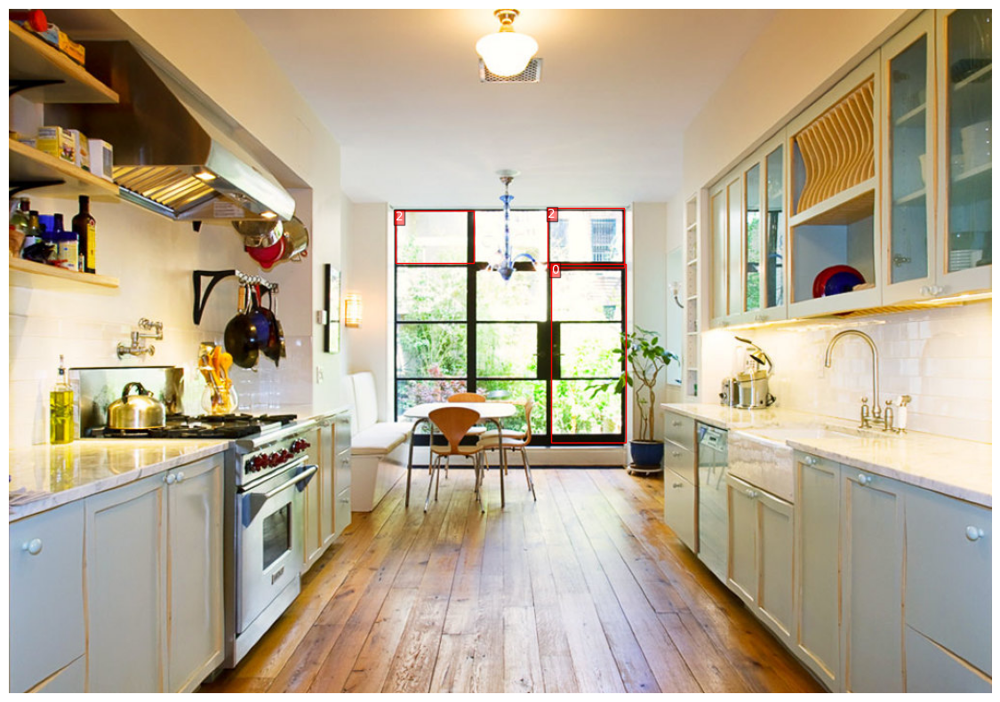

Image size: (375, 500) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[1.0000, 0.7827, 0.8640, 0.3920, 0.2720]], dtype=torch.float64)


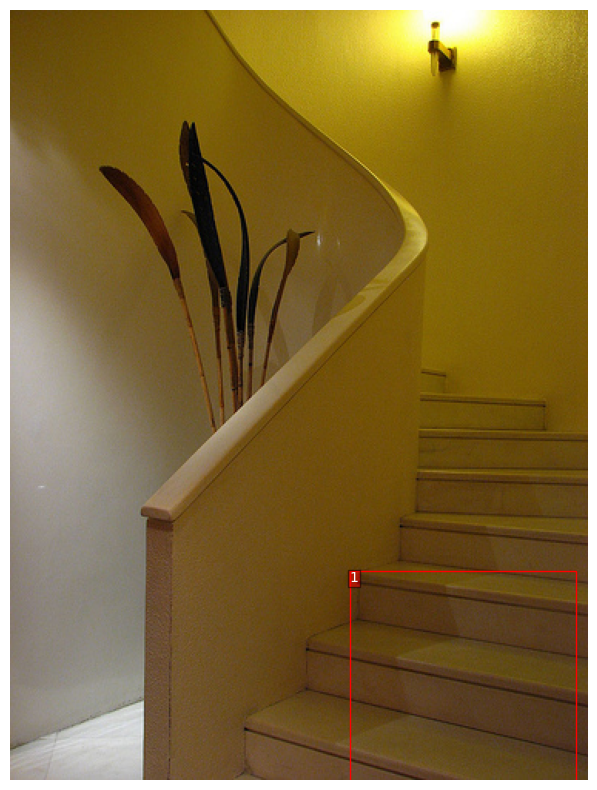

Image size: (1024, 768) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[0.0000, 0.8833, 0.7259, 0.0381, 0.1185]], dtype=torch.float64)


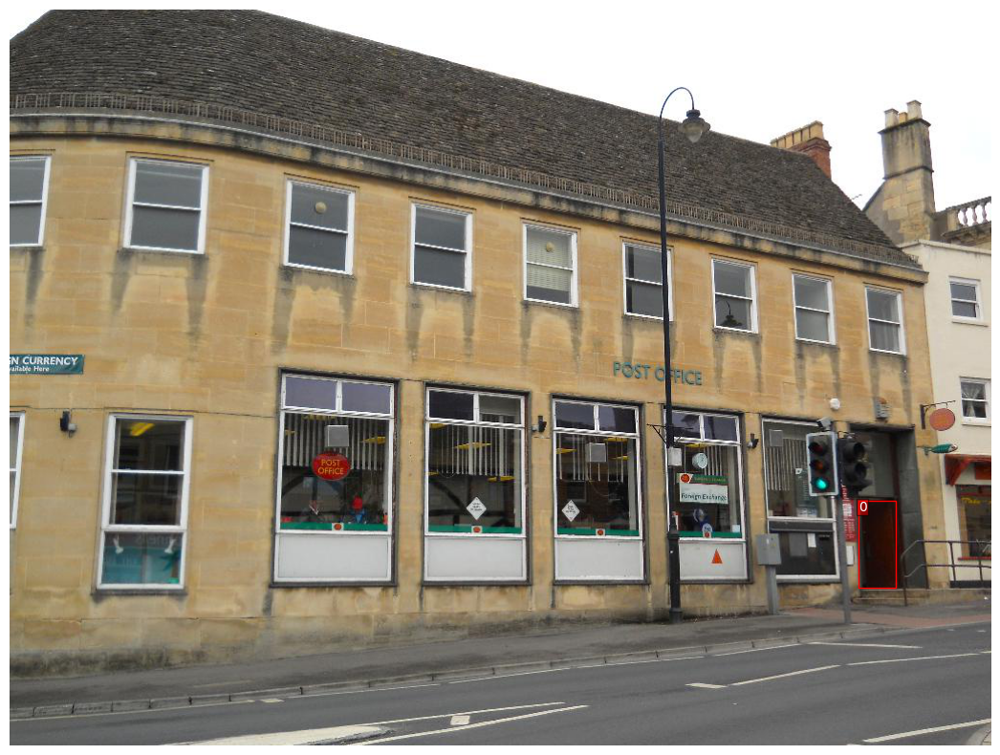

Image size: (1632, 918) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[1.0000, 0.5806, 0.5408, 0.5496, 0.7179]], dtype=torch.float64)


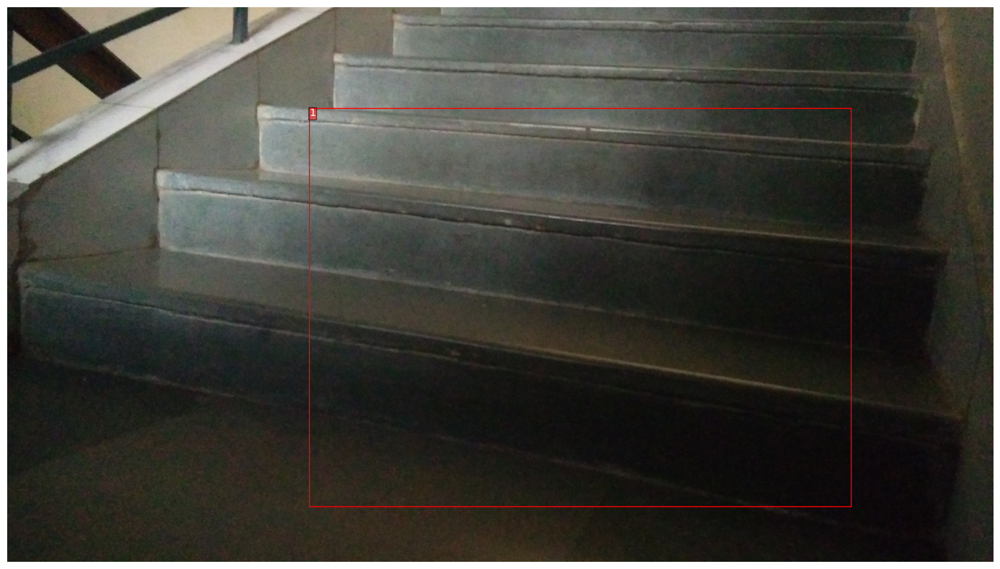

Image size: (683, 1024) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[0.0000, 0.4695, 0.5109, 0.3987, 0.5369]], dtype=torch.float64)


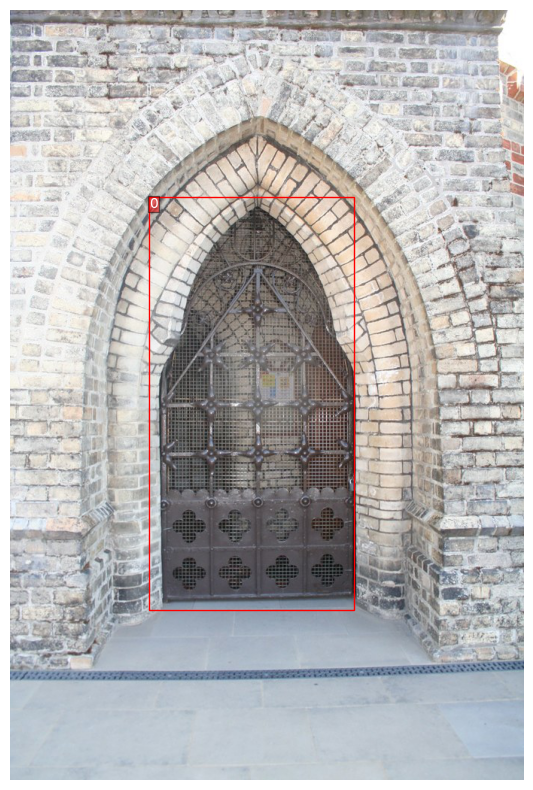

Visualizing samples from window_val:
Image size: (2304, 1728) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[1.0000, 0.4553, 0.6311, 0.7248, 0.4959]], dtype=torch.float64)


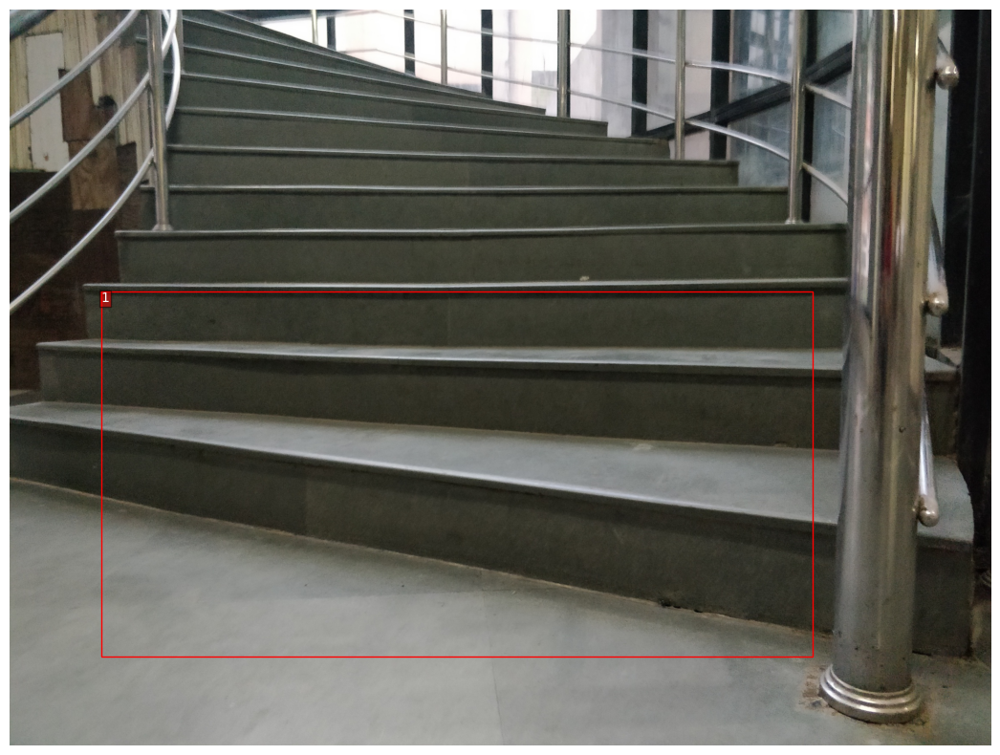

Image size: (2304, 1728) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[1.0000, 0.5870, 0.2581, 0.2109, 0.5000]], dtype=torch.float64)


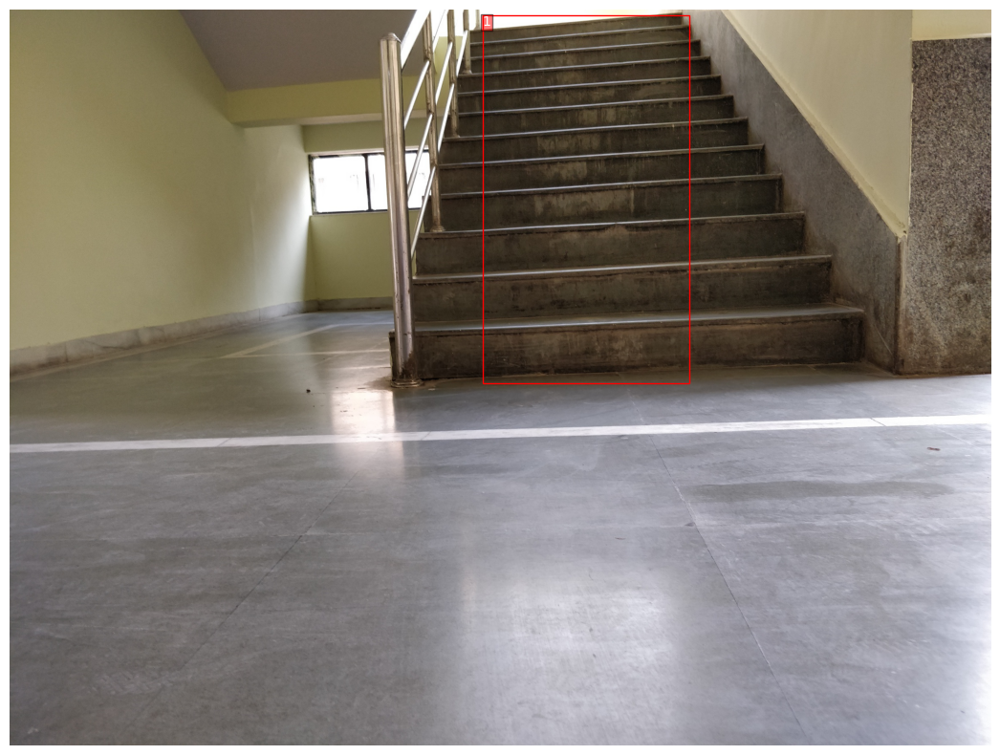

Image size: (682, 1024) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[0.0000, 0.5425, 0.7378, 0.0323, 0.4326]], dtype=torch.float64)


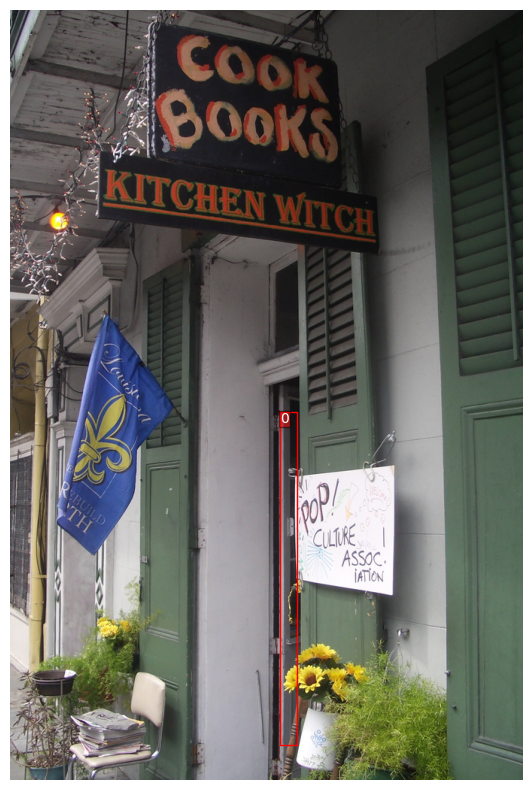

Image size: (1024, 683) <class 'PIL.Image.Image'>
Labels shape: torch.Size([2, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[2.0000, 0.4572, 0.2674, 0.0594, 0.1407],
        [2.0000, 0.6609, 0.2589, 0.2356, 0.2458]], dtype=torch.float64)


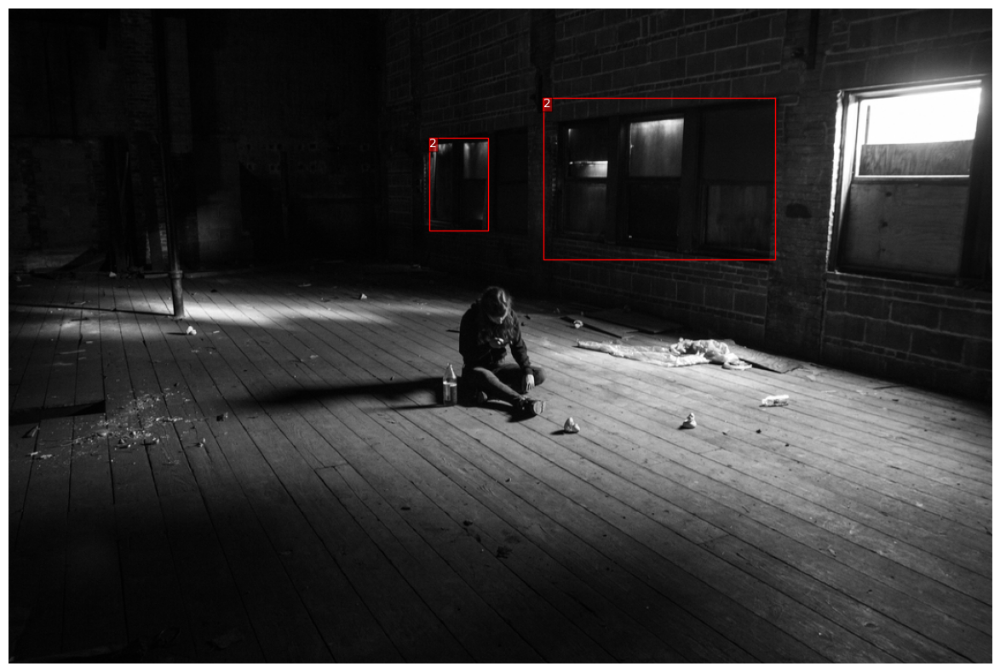

Image size: (500, 386) <class 'PIL.Image.Image'>
Labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
Labels:
 tensor([[1.0000, 0.5070, 0.5790, 0.4100, 0.5725]], dtype=torch.float64)


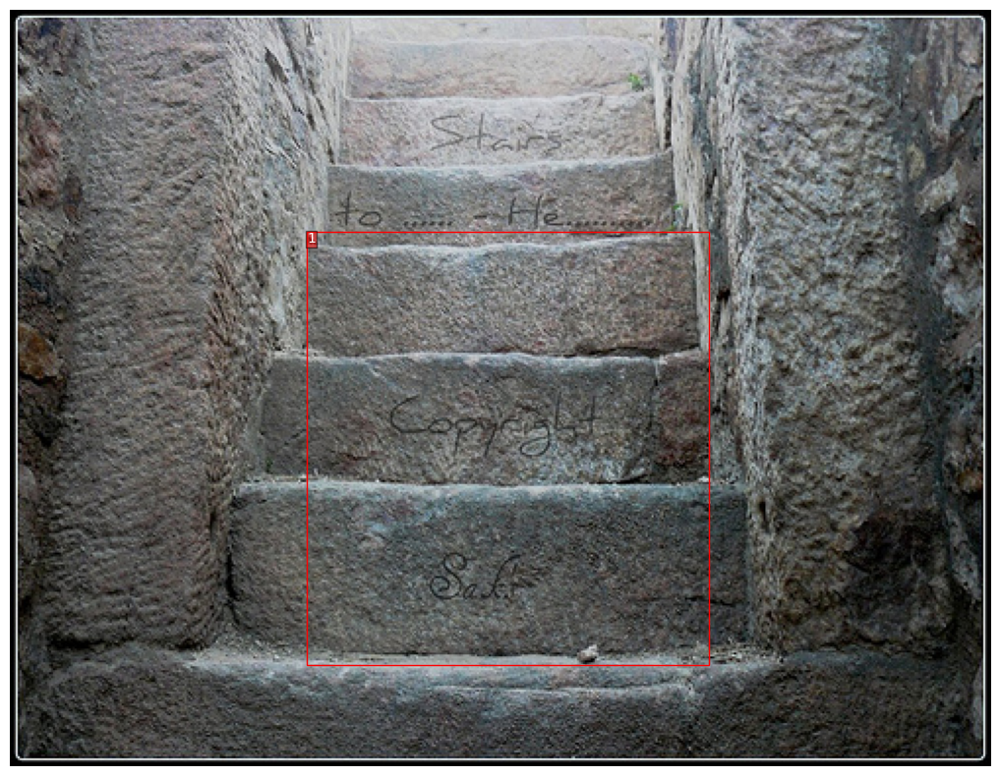

In [ ]:
print("Visualizing samples from Window_train:")
for _ in range(5):
    rnd_ind = np.random.randint(len(Window_train))
    img, labels, path2img = Window_train[rnd_ind]

    print("Image size:", img.size, type(img))
    print("Labels shape:", labels.shape, type(labels))
    print("Labels:\n", labels)

    plt.rcParams['figure.figsize'] = (20, 10)
    plot_image_with_bboxes(img, labels)
    plt.show()

# Set random seed for reproducibility
np.random.seed(60)

# Loop through window_val and visualize samples
print("Visualizing samples from window_val:")
for _ in range(5):
    rnd_ind = np.random.randint(len(window_val))
    img, labels, path2img = window_val[rnd_ind]

    print("Image size:", img.size, type(img))
    print("Labels shape:", labels.shape, type(labels))
    print("Labels:\n", labels)

    plt.rcParams['figure.figsize'] = (20, 10)
    plot_image_with_bboxes(img, labels)
    plt.show()

In [ ]:
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt

def show_img_bbox(img, targets, COLORS):
    if torch.is_tensor(img):
        img = TF.to_pil_image(img)
    if torch.is_tensor(targets):
        targets = targets.numpy()

    W, H = img.size
    draw = ImageDraw.Draw(img)

    for tg in targets:
        id_ = int(tg[0])
        bbox = tg[1:]
        xc, yc, w, h = bbox

        color = [int(c) for c in COLORS[id_]]

        draw.rectangle(((xc - w / 2, yc - h / 2), (xc + w / 2, yc + h / 2)), outline=tuple(color), width=3)
        draw.text((xc - w / 2, yc - h / 2), str(id_), fill=(255, 255, 255, 0))

    plt.imshow(np.array(img))
    plt.axis('off')
    plt.show()

In [ ]:
from PIL import Image, ImageDraw
import torch
import torchvision.transforms.functional as TF
import matplotlib.pyplot as plt
import numpy as np

def hflip(image, labels):
    image = TF.hflip(image)
    labels[:, 1] = 1.0 - labels[:, 1]  # Flip the x-coordinates of bounding boxes
    return image, labels

def vflip(image, labels):
    image = TF.vflip(image)
    labels[:, 2] = 1.0 - labels[:, 2]  # Flip the y-coordinates of bounding boxes
    return image, labels

def adjust_brightness(image, factor):
    enhancer = ImageEnhance.Brightness(image)
    image = enhancer.enhance(factor)
    return image

def adjust_contrast(image, factor):
    enhancer = ImageEnhance.Contrast(image)
    image = enhancer.enhance(factor)
    return image

def pad_to_square(image, labels, normalized_labels=True):
    w, h = image.size
    max_side = max(w, h)
    padded_img = Image.new('RGB', (max_side, max_side), (127, 127, 127))
    padded_img.paste(image, ((max_side - w) // 2, (max_side - h) // 2))

    if normalized_labels:
        labels[:, 1] = (labels[:, 1] * w + (max_side - w) // 2) / max_side
        labels[:, 2] = (labels[:, 2] * h + (max_side - h) // 2) / max_side
        labels[:, 3] = labels[:, 3] * w / max_side
        labels[:, 4] = labels[:, 4] * h / max_side
    else:
        labels[:, 1] += (max_side - w) // 2
        labels[:, 2] += (max_side - h) // 2

    return padded_img, labels

def resize(image, target_size):
    return TF.resize(image, target_size)

In [ ]:
def transformer(image, labels, params):
    # Apply transformations to image
    image = TF.to_tensor(image)
    targets = torch.zeros((len(labels), 6))
    targets[:, 0] = torch.tensor([float(labels.shape[0])])  # Set the number of objects

    # Convert labels from torch.Tensor to np.ndarray
    labels_np = labels.numpy()

    # Assign labels to targets tensor
    targets[:, 1:] = torch.from_numpy(labels_np)

    return image, targets

In [ ]:
import shutil
#
new_data_dir = "./Augmented_data"
if os.path.exists(new_data_dir):
    shutil.rmtree(new_data_dir)
os.makedirs(new_data_dir, exist_ok=True)
os.makedirs(os.path.join(new_data_dir, "train/images"), exist_ok=True)
os.makedirs(os.path.join(new_data_dir, "train/labels"), exist_ok=True)
os.makedirs(os.path.join(new_data_dir, "val/images"), exist_ok=True)
os.makedirs(os.path.join(new_data_dir, "val/labels"), exist_ok=True)

In [ ]:
def save_val_data(dataset, split):
    for i in range(len(dataset)):
        img, labels, path2img = dataset[i]

        img.save(os.path.join(new_data_dir, f"{split}/images/original_{i}.jpg"))

        np.savetxt(os.path.join(new_data_dir, f"{split}/labels/original_{i}.txt"), labels, fmt="%d %.6f %.6f %.6f %.6f")

In [ ]:
import copy

In [ ]:
import os
import torch
import numpy as np
from torchvision import transforms as T
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt

# Define transformations using torchvision transforms
def hflip(image, labels):
    flipped_image = T.functional.hflip(image)
    labels[:, 1] = 1.0 - labels[:, 1]  # Flip the x-coordinates of bounding boxes
    return flipped_image, labels

def vflip(image, labels):
    flipped_image = T.functional.vflip(image)
    labels[:, 2] = 1.0 - labels[:, 2]  # Flip the y-coordinates of bounding boxes
    return flipped_image, labels

def adjust_brightness(image, labels, factor):
    enhancer = T.functional.adjust_brightness(image, factor)
    return enhancer, labels

def adjust_contrast(image, labels, factor):
    enhancer = T.functional.adjust_contrast(image, factor)
    return enhancer, labels

def pad_to_square(image, labels, normalized_labels=True):
    _, h, w = image.size()
    max_side = max(w, h)
    padded_img = torch.zeros((3, max_side, max_side), dtype=torch.float32)
    padded_img[:, (max_side - h) // 2:(max_side - h) // 2 + h, (max_side - w) // 2:(max_side - w) // 2 + w] = image

    if normalized_labels:
        labels[:, 1] = (labels[:, 1] * w + (max_side - w) // 2) / max_side
        labels[:, 2] = (labels[:, 2] * h + (max_side - h) // 2) / max_side
        labels[:, 3] = labels[:, 3] * w / max_side
        labels[:, 4] = labels[:, 4] * h / max_side
    else:
        labels[:, 1] += (max_side - w) // 2
        labels[:, 2] += (max_side - h) // 2

    return padded_img, labels

def resize(image, labels, target_size):
    resized_img = T.functional.resize(image, target_size)
    return resized_img, labels

# Example parameters
trans_params_train = {
    "target_size": (416, 416),
    "pad2square": True,
    "p_hflip": 0.5,
    "p_vflip": 0.5,
    "brightness": 0.9,
    "contrast": 0.9,
    "normalized_labels": True,
}

# Function to save transformed data
def save_transformed_data(dataset, split):
    for i in range(len(dataset)):
        img, labels, path2img = dataset[i]

        # Save original image and labels
        img.save(os.path.join(new_data_dir, f"{split}/images/original_{i}.jpg"))
        np.savetxt(os.path.join(new_data_dir, f"{split}/labels/original_{i}.txt"), labels, fmt="%d %.6f %.6f %.6f %.6f")

        if split == "train":
            transformations = [
                hflip,
                vflip,
                lambda img, labels: adjust_brightness(img, labels, np.random.uniform(0.5, 1.5)),
                lambda img, labels: adjust_contrast(img, labels, np.random.uniform(0.5, 1.5)),
                lambda img, labels: pad_to_square(img, labels, trans_params_train["normalized_labels"]),
                lambda img, labels: resize(img, trans_params_train["target_size"])
            ]

            num_transformations = min(7, len(transformations))
            chosen_transforms = np.random.choice(transformations, num_transformations, replace=False)

            for j, transform in enumerate(chosen_transforms):
                if isinstance(img, torch.Tensor):
                    img_tensor = img.clone()
                else:
                    img_tensor = TF.to_tensor(img)

                img_transformed, labels_transformed = transform(img_tensor, labels)

                if isinstance(img, torch.Tensor):
                    img_transformed_pil = TF.to_pil_image(img_transformed)
                else:
                    img_transformed_pil = img_transformed

                img_transformed_pil.save(os.path.join(new_data_dir, f"{split}/images/transformed_{i}_{j}.jpg"))
                np.savetxt(os.path.join(new_data_dir, f"{split}/labels/transformed_{i}_{j}.txt"), labels_transformed.numpy(), fmt="%d %.6f %.6f %.6f %.6f")

save_transformed_data(Window_train, "train")

def save_image_and_labels(image, labels, img_path, label_path):
    if isinstance(image, torch.Tensor):
        image_np = image.permute(1, 2, 0).numpy().astype(np.uint8)
        image_pil = Image.fromarray(image_np)
    elif isinstance(image, Image.Image):
        image_pil = image
    else:
        raise TypeError("Unsupported image type. Expected torch.Tensor or PIL.Image.")

    image_pil.save(img_path)

    # Save labels
    np.savetxt(label_path, labels.numpy(), fmt="%d %.6f %.6f %.6f %.6f")

# Example usage
save_image_and_labels(window_val, "val")
print("Transformed data saved successfully.")

In [ ]:
import copy

In [ ]:
import torchvision.transforms.functional as TF
import torch

def apply_horizontal_flip(image, labels):
    image = TF.hflip(image)
    labels[:, 1] = 1.0 - labels[:, 1]  # Flip the x-coordinates of bounding boxes
    return image, labels

def apply_vertical_flip(image, labels):
    image = TF.vflip(image)
    labels[:, 2] = 1.0 - labels[:, 2]  # Flip the y-coordinates of bounding boxes
    return image, labels

def apply_brightness(image, labels, factor):
    # Assuming 'factor' is a torch.Tensor or float
    enhancer = TF.ColorJitter(brightness=(factor, factor))
    image = enhancer(image)
    return image, labels

def apply_contrast(image, labels, factor):
    # Assuming 'factor' is a torch.Tensor or float
    image = TF.adjust_contrast(image, factor)
    return image, labels

def pad_to_square(image, labels, normalized_labels=True):
    # Assuming 'labels' is a torch.Tensor
    w, h = image.size
    max_side = max(w, h)
    padded_img = TF.pad(image, (0, 0, (max_side - w) // 2, (max_side - h) // 2), fill=(127, 127, 127))

    if normalized_labels:
        labels[:, 1] = (labels[:, 1] * w + (max_side - w) // 2) / max_side
        labels[:, 2] = (labels[:, 2] * h + (max_side - h) // 2) / max_side
        labels[:, 3] = labels[:, 3] * w / max_side
        labels[:, 4] = labels[:, 4] * h / max_side
    else:
        labels[:, 1] += (max_side - w) // 2
        labels[:, 2] += (max_side - h) // 2

    return padded_img, labels

def resize(image, labels, target_size):
    # Assuming 'labels' is a torch.Tensor
    image = TF.resize(image, target_size)
    return image, labels

In [ ]:
trans_params_save = {
    "target_size": (416, 416),
    "pad2square": True,
    "p_hflip": 0.5,
    "p_vflip": 0.5,
    "brightness": 0.5,
    "contrast": 0.5,
    "normalized_labels": True,
}


In [ ]:
import shutil
import os

# Define the path to the folder you want to delete
folder_to_delete = "./Augmented_data"

try:
    # Check if the folder exists
    if os.path.exists(folder_to_delete):
        # Use shutil.rmtree to delete the folder and its contents recursively
        shutil.rmtree(folder_to_delete)
        print(f"Folder '{folder_to_delete}' successfully deleted.")
    else:
        print(f"Folder '{folder_to_delete}' does not exist.")
except Exception as e:
    print(f"Error occurred while deleting folder '{folder_to_delete}': {e}")

Folder './Augmented_data' successfully deleted.


In [ ]:
def save_transformed_data(dataset, trans_params):
    augmented_data_dir = "./Augmented_data"
    if os.path.exists(augmented_data_dir):
        shutil.rmtree(augmented_data_dir)
    os.makedirs(augmented_data_dir, exist_ok=True)
    os.makedirs(os.path.join(augmented_data_dir, "train/images"), exist_ok=True)
    os.makedirs(os.path.join(augmented_data_dir, "train/labels"), exist_ok=True)

    for i in range(len(dataset)):
        img, labels, path2img = dataset[i]

        img.save(os.path.join(augmented_data_dir, f"train/images/original_{i}.jpg"))
        np.savetxt(os.path.join(augmented_data_dir, f"train/labels/original_{i}.txt"), labels.numpy(), fmt="%d %.6f %.6f %.6f %.6f")

        if "train" in trans_params:  # Ensure it's the training split
            transformations = [
                apply_horizontal_flip,
                apply_vertical_flip,
                lambda img, labels: apply_brightness(img, labels, torch.tensor(np.random.uniform(0.5, 1.5))),
                lambda img, labels: apply_contrast(img, labels, torch.tensor(np.random.uniform(0.5, 1.5))),
                lambda img, labels: pad_to_square(img, labels, trans_params["normalized_labels"]),
                lambda img, labels: resize(img, labels, trans_params["target_size"])
            ]

            num_transformations = min(7, len(transformations))
            chosen_transforms = np.random.choice(transformations, num_transformations, replace=False)

            for j, transform in enumerate(chosen_transforms):
                transformed_img, transformed_labels = transform(img.copy(), labels.copy())
                transformed_img.save(os.path.join(augmented_data_dir, f"train/images/transformed_{i}_{j}.jpg"))
                np.savetxt(os.path.join(augmented_data_dir, f"train/labels/transformed_{i}_{j}.txt"), transformed_labels.numpy(), fmt="%d %.6f %.6f %.6f %.6f")

    print("Transformed data saved successfully.")

def save_val_data(dataset):
    val_data_dir = "./Augmented_data"
    os.makedirs(val_data_dir, exist_ok=True)
    os.makedirs(os.path.join(val_data_dir, "val/images"), exist_ok=True)
    os.makedirs(os.path.join(val_data_dir, "val/labels"), exist_ok=True)

    for i in range(len(dataset)):
        img, labels, path2img = dataset[i]

        img.save(os.path.join(val_data_dir, f"val/images/original_{i}.jpg"))
        np.savetxt(os.path.join(val_data_dir, f"val/labels/original_{i}.txt"), labels.numpy(), fmt="%d %.6f %.6f %.6f %.6f")

    print("Validation data saved successfully.")

# Example usage:
save_transformed_data(Window_train, trans_params_save)
save_val_data(window_val)

<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/train/labels/00bccfe3f3c8ae6b.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/train/labels/27a6bcd97e626d69.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/train/labels/02a9c760af8f7a08.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/train/labels/246b474d6ea03d80.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/train/labels/0d2090ea279cafee.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Wind

Transformed data saved successfully.


<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/val/labels/32a5a75aff331bbc.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/val/labels/24e3ee52ac1821a9.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/val/labels/022594ed9ec74a86.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/val/labels/01f460320a53fc91.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/val/labels/85ccc9bbdf4d6985.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)
<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Window_data/va

Validation data saved successfully.


In [ ]:
Augmented_data_dir = "./Window_data"
Aug_window_train = Window_Data(root_dir=Augmented_data_dir, subset="train", transform=None)
print("len of train",len(Aug_window_train))
Aug_window_val = Window_Data(root_dir=Augmented_data_dir, subset="val", transform=None)
print("len of val",len(Aug_window_val))

len of train 1051
len of val 451


In [ ]:
img, labels, path2img = Aug_window_train[1000]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)
img, labels, path2img = Aug_window_val[1]
print("image size:", img.size, type(img))
print("labels shape:", labels.shape, type(labels))
print("labels \n", labels)

image size: (1024, 688) <class 'PIL.Image.Image'>
labels shape: torch.Size([3, 5]) <class 'torch.Tensor'>
labels 
 tensor([[0.0000, 0.0762, 0.4993, 0.1133, 0.2544],
        [0.0000, 0.1807, 0.4891, 0.0859, 0.2166],
        [0.0000, 0.2603, 0.4811, 0.0654, 0.1890]], dtype=torch.float64)
image size: (768, 1024) <class 'PIL.Image.Image'>
labels shape: torch.Size([1, 5]) <class 'torch.Tensor'>
labels 
 tensor([[0.0000, 0.3208, 0.5072, 0.6267, 0.9819]], dtype=torch.float64)


# **Defining Data LoAders**

In [ ]:
def transformer(image, labels, params):
    if params["pad2square"]:
        image, labels = pad_to_square(image, labels, normalized_labels=params["normalized_labels"])

    image = resize(image, params["target_size"])

    if random.random() < params["p_hflip"]:
        image, labels = hflip(image, labels)

    if random.random() < params["p_vflip"]:
        image, labels = vflip(image, labels)

    if "brightness" in params:
        image = adjust_brightness(image, params["brightness"])

    if "contrast" in params:
        image = adjust_contrast(image, params["contrast"])

    image = TF.to_tensor(image)
    targets = torch.zeros((len(labels), 6))
    targets[:, 1:] = torch.from_numpy(labels)

    return image, targets


In [ ]:
import torch
import torchvision.transforms.functional as TF
from PIL import Image
def collate_fn(batch, target_size=(416, 416)):
    images = []
    targets = []
    paths = []

    for img, labels, path2img in batch:
        # Ensure img is a PIL Image
        if not isinstance(img, Image.Image):
            raise TypeError(f"Expected img to be PIL Image, but got {type(img)}")

        # Convert labels to numpy array if it's a tensor
        if isinstance(labels, torch.Tensor):
            labels = labels.numpy()
        elif not isinstance(labels, np.ndarray):
            raise TypeError(f"Expected labels to be numpy array or torch.Tensor, but got {type(labels)}")

        # Resize image to target size
        img = TF.resize(img, target_size)
        images.append(to_tensor(img))
        targets.append(torch.tensor(labels, dtype=torch.float32))
        paths.append(path2img)

    images = torch.stack(images, dim=0)

    # Stack all targets into a single tensor
    max_num_labels = max(t.shape[0] for t in targets)
    padded_targets = torch.zeros((len(targets), max_num_labels, targets[0].shape[1]))

    for i, t in enumerate(targets):
        padded_targets[i, :t.shape[0], :] = t

    return images, padded_targets, paths

In [ ]:
from torch.utils.data import DataLoader
batch_size = 8
target_size = (416, 416)

# Example: Assuming Aug_window_train and Aug_window_val are instances of MyDataset
train_dl = DataLoader(
    Aug_window_train,
    batch_size=batch_size,
    shuffle=True,
    num_workers=0,
    pin_memory=True,
    collate_fn=lambda batch: collate_fn(batch, target_size)
)

val_dl = DataLoader(
    Aug_window_val,
    batch_size=batch_size,
    shuffle=False,
    num_workers=0,
    pin_memory=True,
    collate_fn=lambda batch: collate_fn(batch, target_size)
)


In [ ]:

# Print batch information for train and val
print("train :")
for images, targets, paths in train_dl:
    print("Batch of images type:", type(images))
    print("Batch of images shape:", images.shape)
    print("Batch of targets type:", type(targets))
    print("Batch of targets shape:", targets.shape)
    print("Batch of paths type:", type(paths))
    print("Batch of paths:", paths)
    break

print("val :")
for images, targets, paths in val_dl:
    print("Batch of images type:", type(images))
    print("Batch of images shape:", images.shape)
    print("Batch of targets type:", type(targets))
    print("Batch of targets shape:", targets.shape)
    print("Batch of paths type:", type(paths))
    print("Batch of paths:", paths)
    break

train :
Batch of images type: <class 'torch.Tensor'>
Batch of images shape: torch.Size([8, 3, 416, 416])
Batch of targets type: <class 'torch.Tensor'>
Batch of targets shape: torch.Size([8, 8, 5])
Batch of paths type: <class 'list'>
Batch of paths: ['./Augmented_data/train/images/original_937.jpg', './Augmented_data/train/images/original_1461.jpg', './Augmented_data/train/images/original_3240.jpg', './Augmented_data/train/images/original_2839.jpg', './Augmented_data/train/images/original_1558.jpg', './Augmented_data/train/images/original_2895.jpg', './Augmented_data/train/images/original_1466.jpg', './Augmented_data/train/images/original_3474.jpg']
val :
Batch of images type: <class 'torch.Tensor'>
Batch of images shape: torch.Size([8, 3, 416, 416])
Batch of targets type: <class 'torch.Tensor'>
Batch of targets shape: torch.Size([8, 56, 5])
Batch of paths type: <class 'list'>
Batch of paths: ['./Augmented_data/val/images/original_1415.jpg', './Augmented_data/val/images/original_368.jpg

<ipython-input-13-21639ad08eb1>:30: UserWarning: loadtxt: input contained no data: "./Augmented_data/val/labels/original_1415.txt"
  labels = np.loadtxt(path2label).reshape(-1, 5)


In [ ]:
print(len(train_dl))
print(len(val_dl))

439
189


In [15]:
!git clone https://github.com/ultralytics/yolov5
!cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 16772, done.
remote: Counting objects: 100% (313/313), done.
remote: Compressing objects: 100% (230/230), done.
remote: Total 16772 (delta 171), reused 159 (delta 83), pack-reused 16459
Receiving objects: 100% (16772/16772), 15.47 MiB | 28.86 MiB/s, done.
Resolving deltas: 100% (11470/11470), done.


In [22]:
import shutil
import os

def move_file(src_path, dest_folder):
    # Check if the source file exists
    if not os.path.exists(src_path):
        print(f"Error: The file '{src_path}' does not exist.")
        return

    # Check if the destination folder exists; if not, create it
    if not os.path.exists(dest_folder):
        os.makedirs(dest_folder)

    # Extract the file name from the source path
    file_name = os.path.basename(src_path)

    # Construct the destination path
    dest_path = os.path.join(dest_folder, file_name)

    try:
        # Perform the move operation
        shutil.move(src_path, dest_path)
        print(f"File '{file_name}' moved successfully to '{dest_folder}'.")
    except Exception as e:
        print(f"Error: Failed to move file '{file_name}'.")
        print(f"Exception: {e}")

# Example usage:
if __name__ == "__main__":
    source_path = "/content/door.yaml"
    destination_folder = "/content/yolov5/data"

    move_file(source_path, destination_folder)

File 'door.yaml' moved successfully to '/content/yolov5/data'.


In [28]:
import os
import numpy as np

def save_yolo_format(dataset, split, output_dir):
    images_dir = os.path.join(output_dir, split, "images")
    labels_dir = os.path.join(output_dir, split, "labels")
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

    for i in range(len(dataset)):
        img, labels, path2img = dataset[i]

        # Check if labels are empty
        if labels.size == False:
            print(f"Skipping empty labels for image: {path2img}")
            continue

        img_name = f"{split}_{i}.jpg"
        label_name = f"{split}_{i}.txt"

        img.save(os.path.join(images_dir, img_name))

        try:
            np.savetxt(os.path.join(labels_dir, label_name), labels, fmt="%d %.6f %.6f %.6f %.6f")
        except ValueError as e:
            print(f"Error saving labels for image {path2img}: {e}")
            continue

# Example usage:
output_dir = "./yolo_data"
save_yolo_format(Window_train, "train", output_dir)
save_yolo_format(window_val, "val", output_dir)

In [29]:
!cd yolov5/
!python yolov5/train.py --img 416 --batch 16 --epochs 50 --data door.yaml --weights yolov5l.pt

2024-07-13 10:51:05.300949: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-13 10:51:05.300994: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-13 10:51:05.302442: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5l.pt, cfg=, data=door.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=yolov5/data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cl

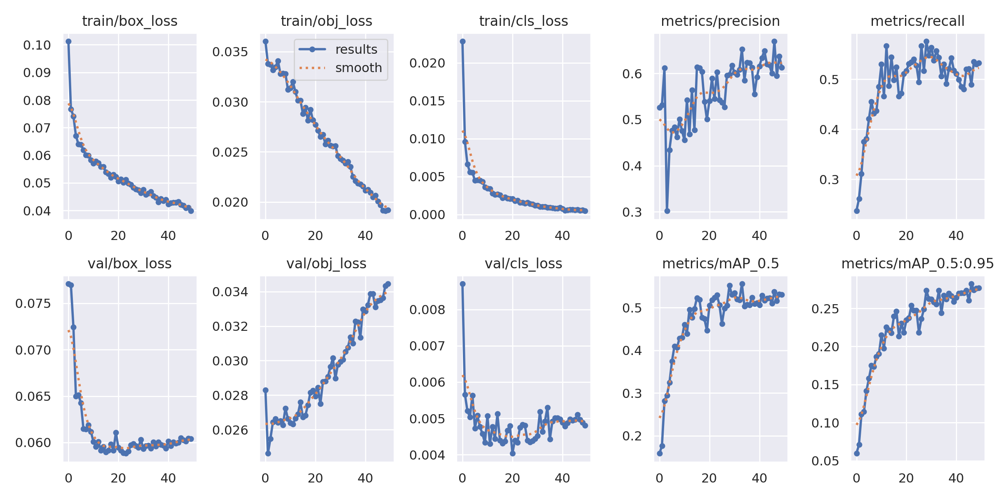

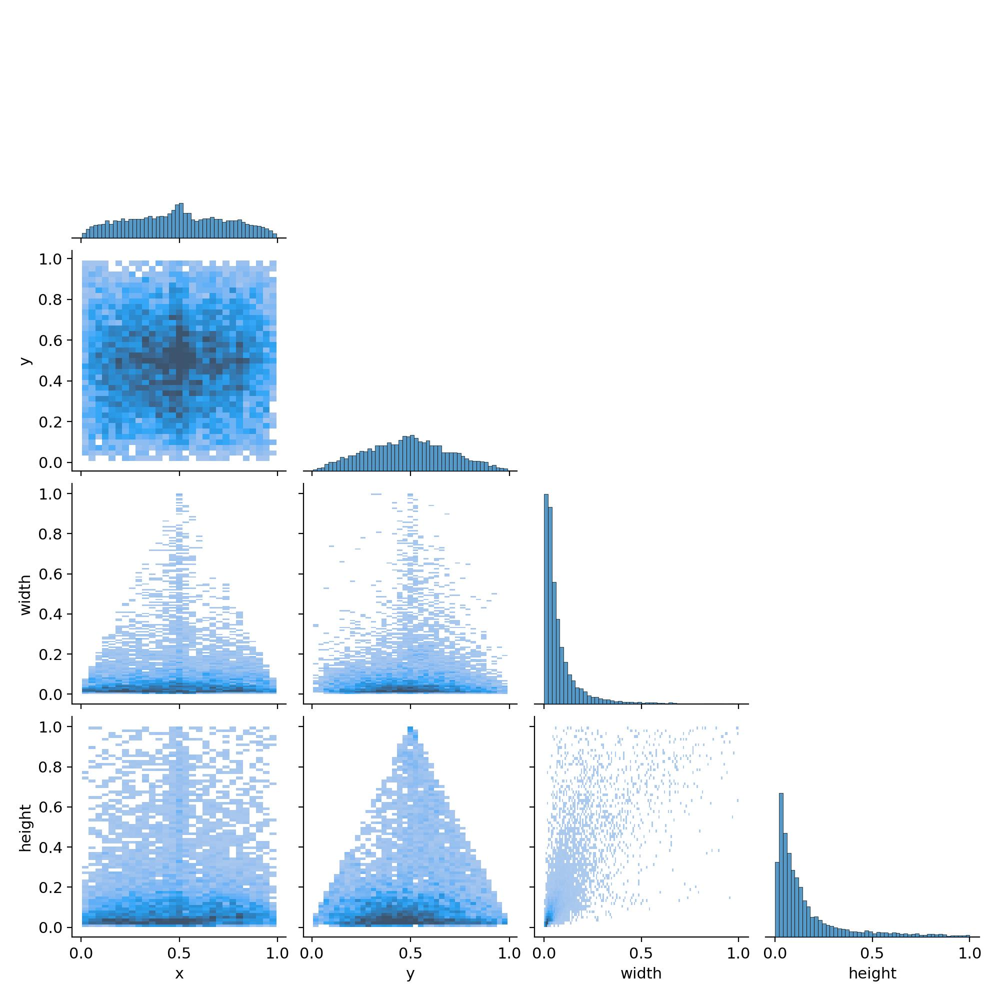

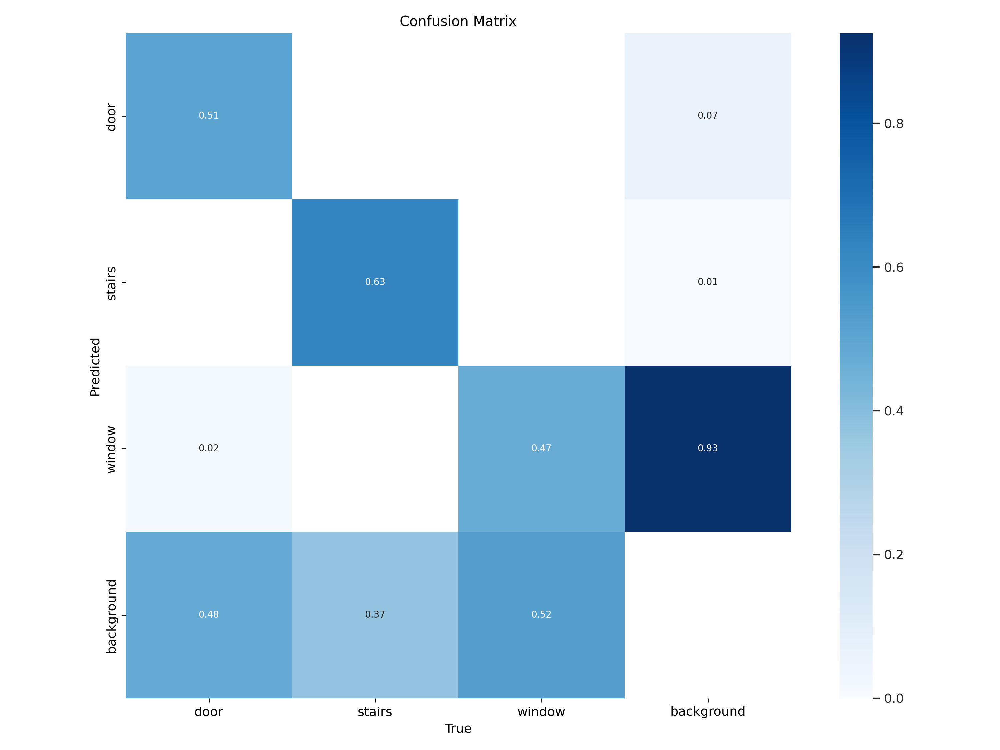

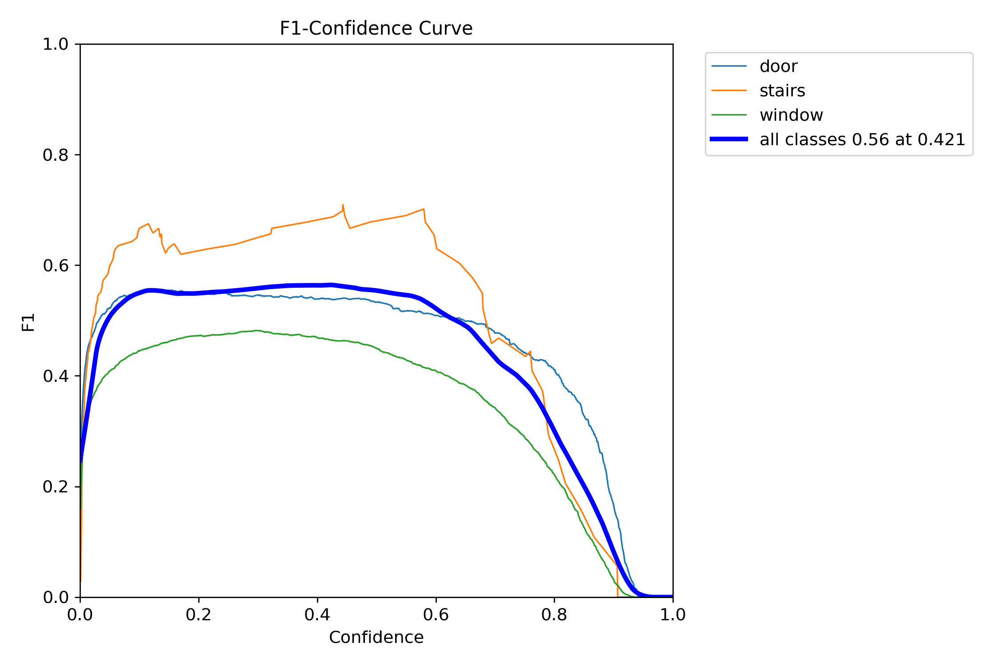

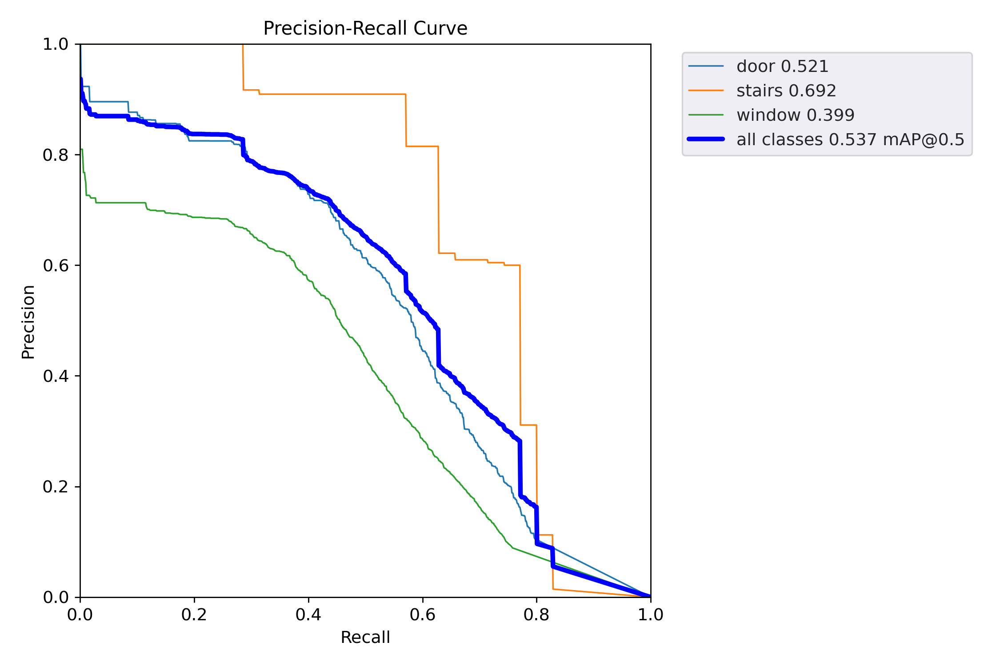

In [30]:
import os
import matplotlib.pyplot as plt
from IPython.display import Image, display

results_dir = './yolov5/runs/train/exp4'

# Function to display images
def display_image(image_path):
    if os.path.exists(image_path):
        display(Image(filename=image_path))
    else:
        print(f"{image_path} does not exist")

# Display training results
results_files = [
    'results.png',
    'labels_correlogram.jpg',
    'confusion_matrix.png',
    'F1_curve.png',
    'PR_curve.png'
]

for file in results_files:
    display_image(os.path.join(results_dir, file))

In [31]:
weights_dir = os.path.join(results_dir, 'weights')
if os.path.exists(weights_dir):
    print("Contents of weights directory:")
    for file_name in os.listdir(weights_dir):
        print(file_name)
else:
    print("Weights directory does not exist")

Contents of weights directory:
best.pt
last.pt


In [32]:
model_path = os.path.join(weights_dir, 'best.pt')
model = torch.hub.load('ultralytics/yolov5', 'custom', path=model_path)

/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-7-13 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 267 layers, 46119048 parameters, 0 gradients, 107.7 GFLOPs
Adding AutoShape... 


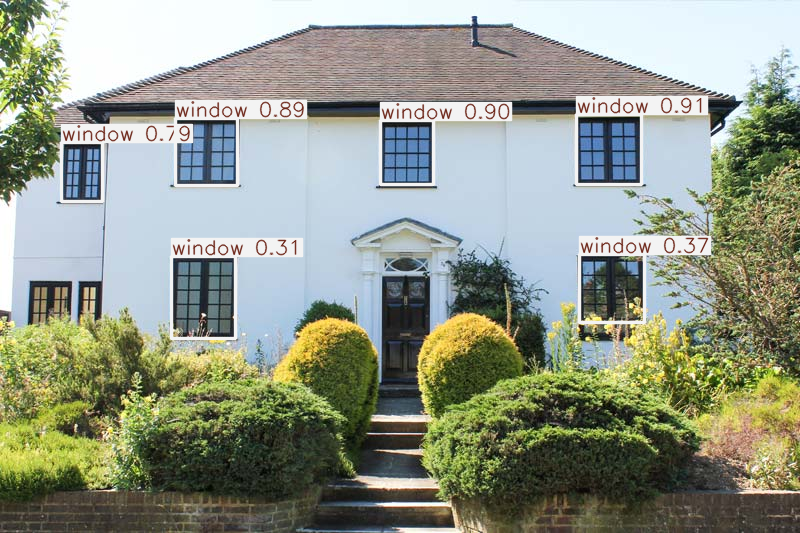

In [35]:
image_path = '/content/w.jpg'
results = model(image_path)
results.show()

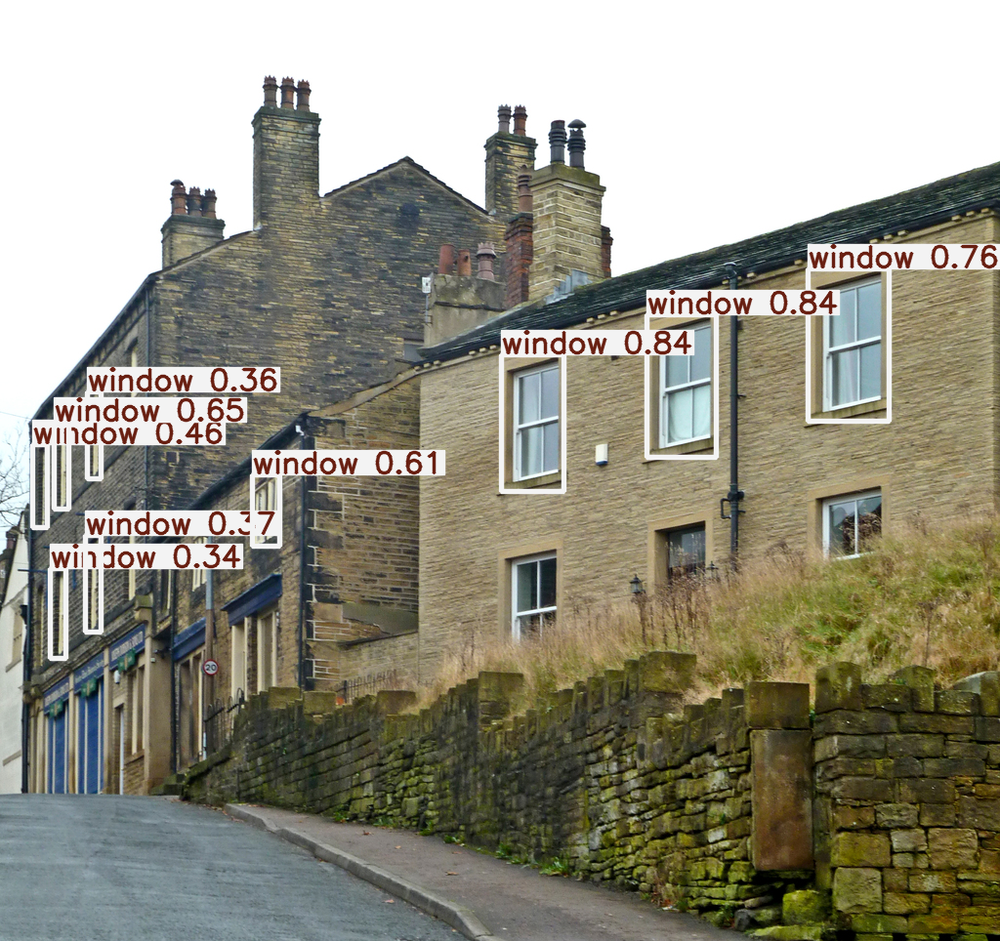

In [36]:
image_path = './Window_data/val/images/03a13effeb7a0cde.jpg'
results = model(image_path)
results.show()

In [37]:
import shutil
import os
from google.colab import files

# Path to the folder to be zipped
folder_path = 'yolov5/runs/train/exp4'
zip_file_path = 'exp4.zip'

# Create a ZIP file
shutil.make_archive('exp4', 'zip', folder_path)

# Provide a download link for the zip file
print(f"Folder '{folder_path}' has been zipped as '{zip_file_path}'.")

# Download the file
files.download(zip_file_path)

Folder 'yolov5/runs/train/exp4' has been zipped as 'exp4.zip'.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>